# Library

In [26]:
import numpy as np
import copy
import matplotlib.pyplot as plt
from PIL import Image

from tqdm import tqdm

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader
import torchvision.models as models
from torchvision.utils import save_image
from torchvision import datasets, transforms

In [2]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [3]:
# 이미지를 불러와 다운받아 텐서(Tensor) 객체로 변환하는 함수
def image_loader(img_path, imsize):
    loader = transforms.Compose([
        transforms.Resize(imsize), # 이미지의 크기를 변경
        transforms.ToTensor() # torch.Tensor 형식으로 변경 [0, 255] → [0, 1]
    ])
    image = Image.open(img_path)
    # 네트워크 입력에 들어갈 이미지에 배치 목적의 차원(dimension) 추가
    image = loader(image).unsqueeze(0)
    return image.to(device, torch.float) # GPU로 올리기


# torch.Tensor 형태의 이미지를 화면에 출력하는 함수
def imshow(tensor):
    # matplotlib는 CPU 기반이므로 CPU로 옮기기
    image = tensor.cpu().clone()
    # torch.Tensor에서 사용되는 배치 목적의 차원(dimension) 제거
    image = image.squeeze(0)
    # PIL 객체로 변경
    image = transforms.ToPILImage()(image)
    # 이미지를 화면에 출력(matplotlib는 [0, 1] 사이의 값이라고 해도 정상적으로 처리)
    plt.imshow(image)
    plt.show()

# Style Transfer

paper: [Style Transfer](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf)

<br>

<img src="https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FcWuuWh%2FbtrIjOYd881%2FejfoOp5qnyEdrhWN40OpS1%2Fimg.png" width=500>

content image에 style image의 화풍을 적용해 새로운 이미지를 생성하는 기법.


## 학습 방법

<img src="https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FCVCpx%2FbtsiQ6gtkqS%2FoKUPcdqJMYKR1rBDJeWQCK%2Fimg.png" width=600>

### Image Update

![](https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2Fcm7yMv%2FbtsiNcWAWhv%2Fl9XQwOuseJ3OkXtr3LyIj1%2Fimg.png)

<br>

모델의 weight를 업데이트 하는 것이 아닌 image의 값을 update

In [18]:
image_path = './images/cat.jpg'
target_image = image_loader(image_path, (512, 512))

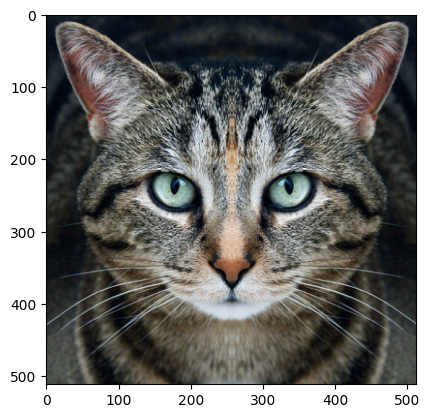

In [19]:
imshow(target_image)

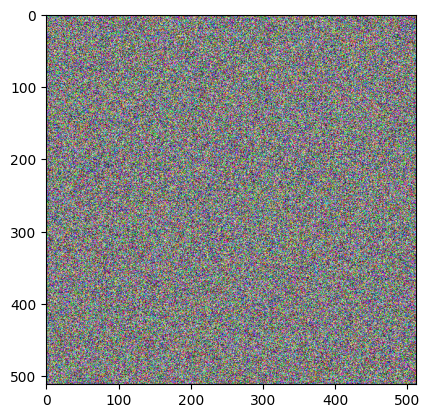

In [20]:
noise_image = torch.empty_like(target_image).uniform_(0, 1).to(device)
imshow(noise_image)

In [21]:
criterion = nn.MSELoss()
learning_rate = 1e4

noise_image.requires_grad = True

In [22]:
loss = criterion(noise_image, target_image)
loss.backward()

In [23]:
gradient = learning_rate * noise_image.grad
noise_image = torch.clamp(noise_image - gradient, min=0, max=1).detach_()
noise_image

tensor([[[[0.0393, 0.7310, 0.5137,  ..., 0.1428, 0.9732, 0.5405],
          [0.9336, 0.9334, 0.7382,  ..., 0.6302, 0.1855, 0.9510],
          [0.9140, 0.7631, 0.6406,  ..., 0.7813, 0.2356, 0.1391],
          ...,
          [0.2506, 0.3449, 0.3471,  ..., 0.9591, 0.3487, 0.9153],
          [0.9114, 0.3541, 0.3733,  ..., 0.7545, 0.3670, 0.1824],
          [0.8570, 0.6850, 0.4391,  ..., 0.7240, 0.5846, 0.0255]],

         [[0.2480, 0.6228, 0.6284,  ..., 0.2870, 0.9167, 0.7190],
          [0.5317, 0.0494, 0.5501,  ..., 0.8973, 0.7941, 0.7164],
          [0.1992, 0.7825, 0.4631,  ..., 0.0210, 0.6222, 0.5972],
          ...,
          [0.5296, 0.6091, 0.3369,  ..., 0.4912, 0.2464, 0.7804],
          [0.0769, 0.5493, 0.1566,  ..., 0.8239, 0.6143, 0.5715],
          [0.6124, 0.3840, 0.1792,  ..., 0.3161, 0.0649, 0.5052]],

         [[0.9032, 0.2288, 0.1380,  ..., 0.5381, 0.4372, 0.5692],
          [0.6295, 0.5337, 0.7530,  ..., 0.7896, 0.9256, 0.8414],
          [0.0964, 0.4313, 0.8971,  ..., 0

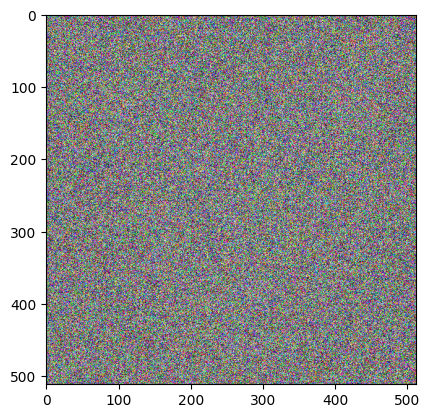

In [24]:
imshow(noise_image)

start


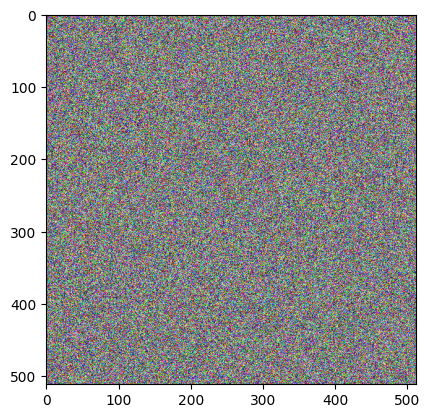

epoch: 5 | loss: 0.13515500724315643


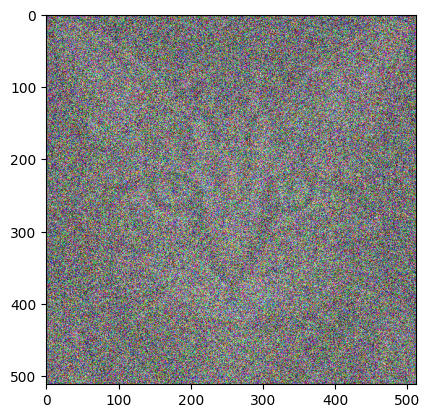

epoch: 10 | loss: 0.10446160286664963


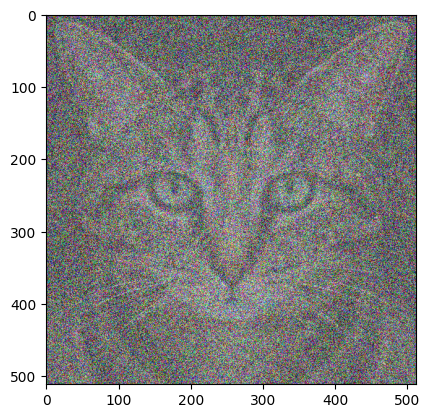

epoch: 15 | loss: 0.08073858916759491


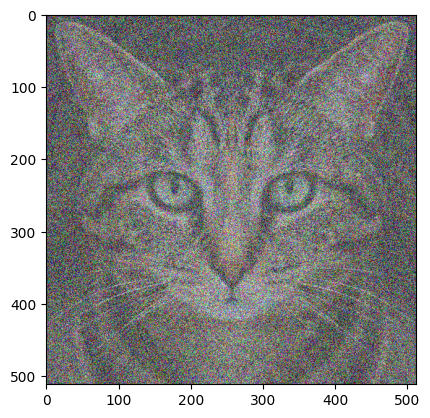

epoch: 20 | loss: 0.06240302324295044


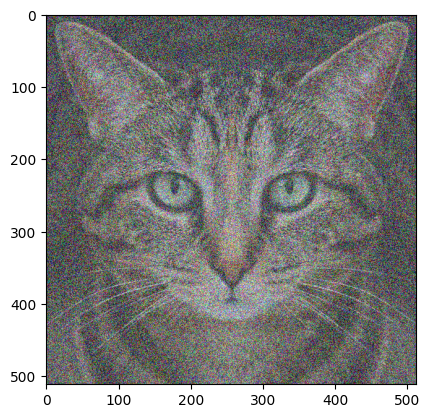

epoch: 25 | loss: 0.04823144152760506


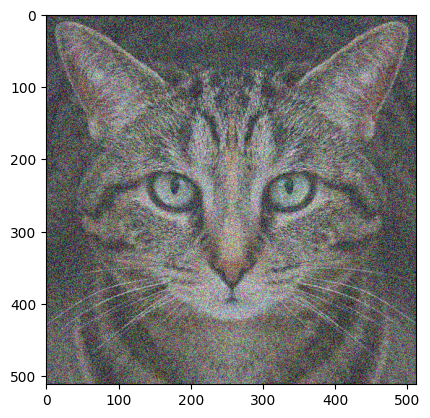

epoch: 30 | loss: 0.037278179079294205


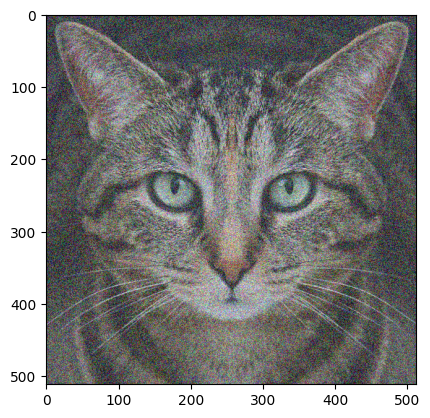

epoch: 35 | loss: 0.028812387958168983


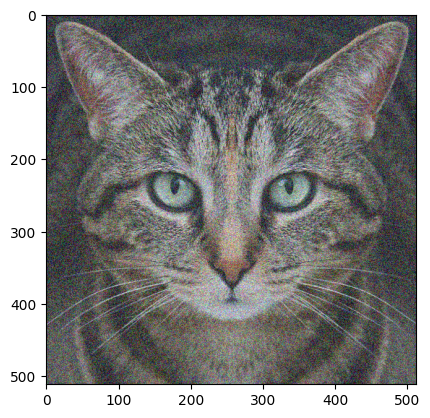

epoch: 40 | loss: 0.022269153967499733


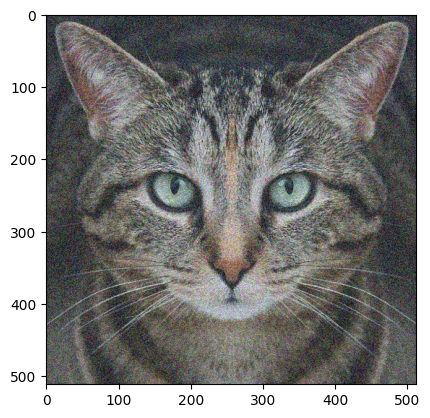

epoch: 45 | loss: 0.017211878672242165


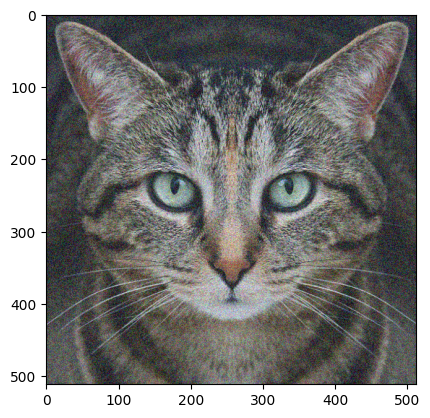

epoch: 50 | loss: 0.01330309733748436


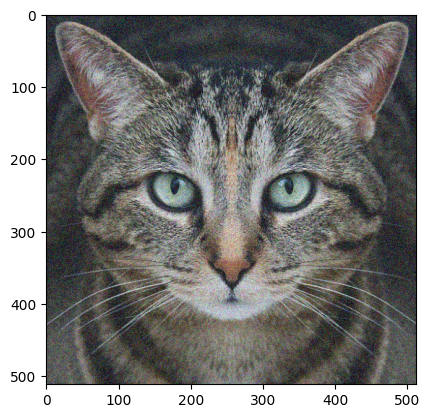

epoch: 55 | loss: 0.010281992144882679


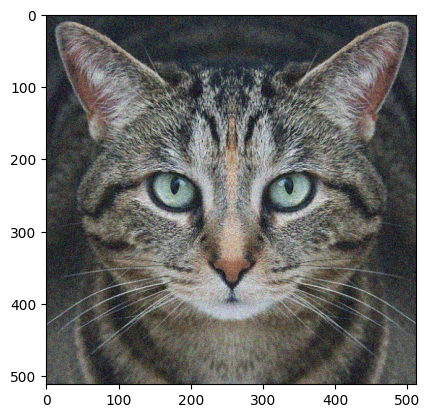

epoch: 60 | loss: 0.007946974597871304


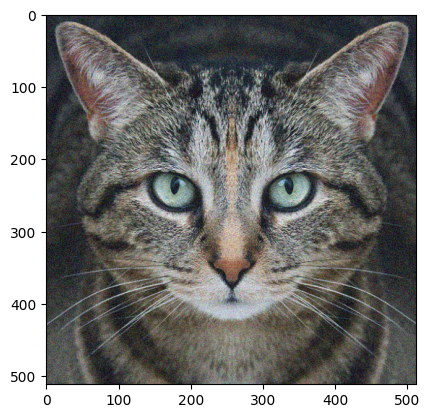

epoch: 65 | loss: 0.006142233032733202


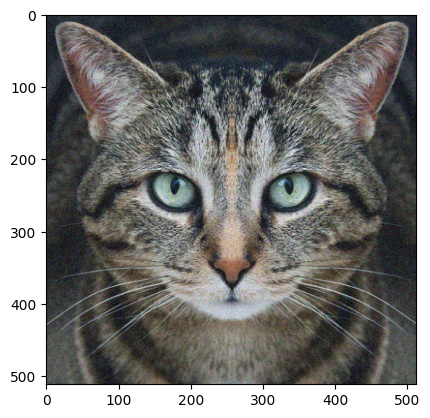

epoch: 70 | loss: 0.004747345577925444


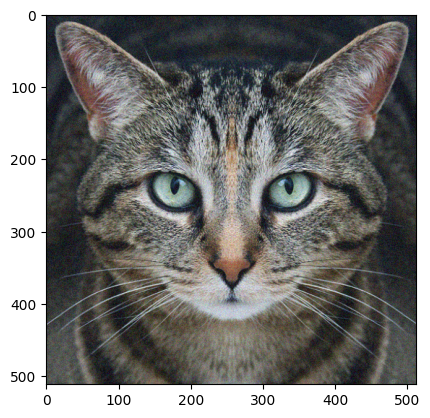

epoch: 75 | loss: 0.0036692332942038774


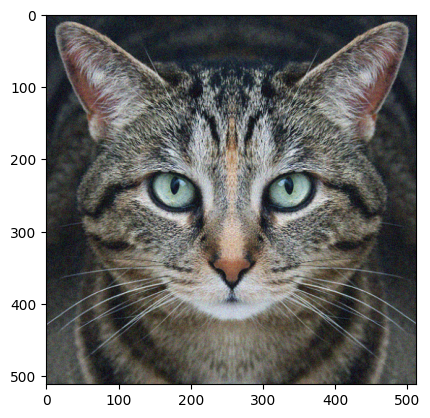

epoch: 80 | loss: 0.0028359584975987673


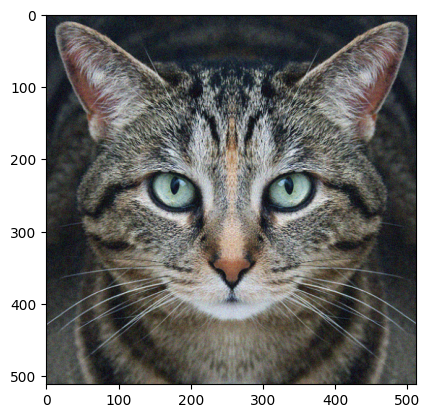

epoch: 85 | loss: 0.002191918669268489


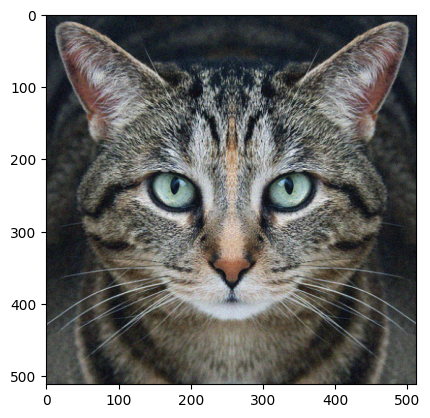

epoch: 90 | loss: 0.0016941385110840201


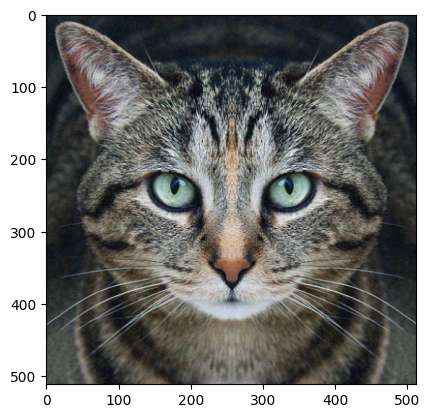

epoch: 95 | loss: 0.0013094033347442746


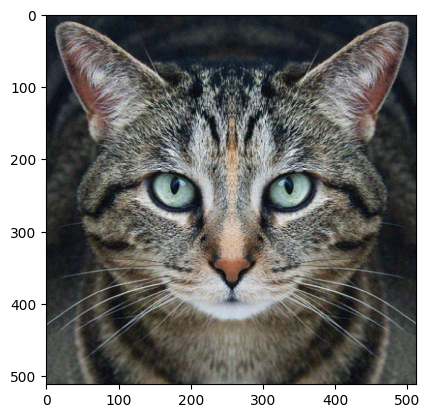

epoch: 100 | loss: 0.0010120406514033675


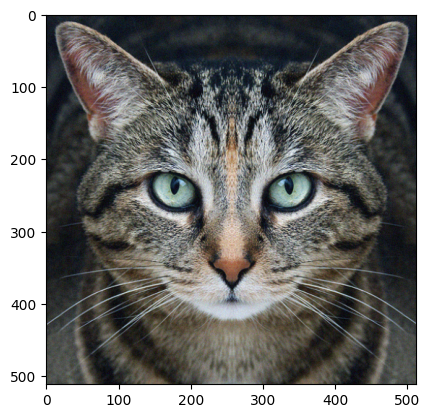

In [29]:
epochs = 100
loss = nn.MSELoss()
learning_rate = 1e4

target_image = image_loader(image_path, (512, 512))
noise_image = torch.empty_like(target_image).uniform_(0, 1).to(device)

print(f'start')
imshow(noise_image)

for epoch in range(1, epochs+1):
    noise_image.requires_grad = True

    loss = criterion(noise_image, target_image)
    loss.backward()

    gradient = learning_rate * noise_image.grad
    noise_image = noise_image - gradient
    noise_image = torch.clamp(noise_image, min=0, max=1).detach_()

    if epoch%5 == 0:
        print(f'epoch: {epoch} | loss: {loss}')
        imshow(noise_image)

### Loss Function

<img src="https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2F6DZDp%2FbtsiBKNlML3%2FHbh9uCE17oOkc2uAuR5Vy0%2Fimg.png" width=500>

<br>

random noise 이미지에 style과 content의 정보를 가져올 수 있도록 update
- $ \vec{x} $: noise image
- $ \vec{p} $: content image
- $ \vec{a} $: style image

<br>

content loss는 noise와 content 사이의 차를 의미하며, loss가 낮다는 건 content의 정보를 잘 가지고 왔음을 의미. <br>
style loss는 noise와 style 사이의 차를 의미하며, loss가 낮다는 건 style의 정보를 잘 가지고 왔음을 의미. <br>

[ Content Image ]


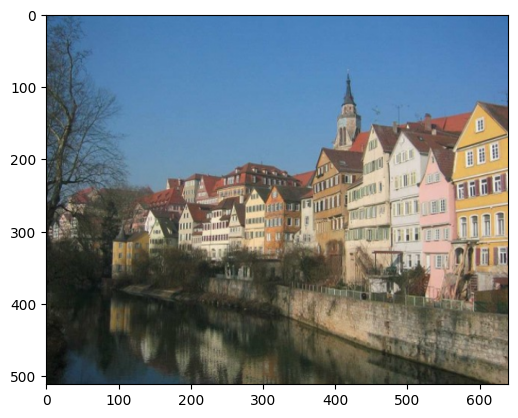

[ Style Image ]


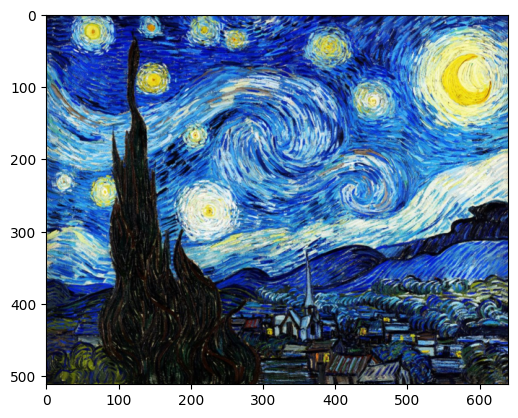

In [17]:
# 콘텐츠(Content) 이미지와 스타일(Style) 이미지를 모두 준비합니다.
content_img = image_loader('./images/content_img_1.jpg', (512, 640))
style_img = image_loader('./images/style_img_1.jpg', (512, 640))

print("[ Content Image ]")
imshow(content_img)
print("[ Style Image ]")
imshow(style_img)

In [30]:
# 뉴럴 네트워크 모델을 불러옵니다.
cnn = models.vgg19(pretrained=True).features.to(device).eval()

C:\Users\USER\AppData\Roaming\Python\Python310\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\USER\AppData\Roaming\Python\Python310\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to C:\Users\USER/.cache\torch\hub\checkpoints\vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:08<00:00, 70.2MB/s] 


In [31]:
# 입력 정규화(Normalization)를 위한 초기화
cnn_normalization_mean = torch.tensor([0.485, 0.456, 0.406]).to(device)
cnn_normalization_std = torch.tensor([0.229, 0.224, 0.225]).to(device)

class Normalization(nn.Module):
    def __init__(self, mean, std):
        super(Normalization, self).__init__()
        self.mean = mean.clone().reshape(-1, 1, 1)
        self.std = std.clone().reshape(-1, 1, 1)

    def forward(self, img):
        return (img-self.mean) / self.std

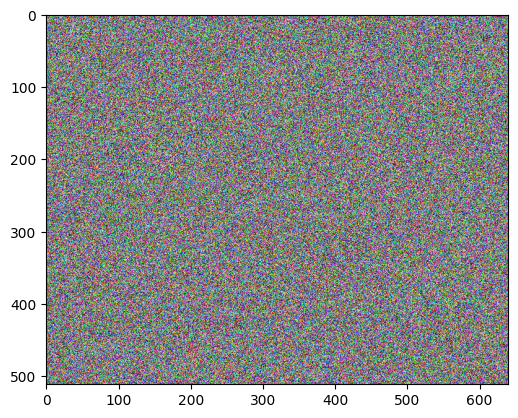

In [32]:
# 콘텐츠 이미지와 동일한 크기의 노이즈 이미지 준비하기
input_img = torch.empty_like(content_img).uniform_(0, 1).to(device)
imshow(input_img)

In [34]:
nn.Conv2d(3, 64, kernel_size=2)(input_img).shape

torch.Size([1, 64, 511, 639])

#### Content Loss

<img src="https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FbOJUeB%2FbtsiOHaOvx9%2FaGiQi2tMuyDLMBWkOtlKE1%2Fimg.png" width=500>

<br>

$ \vec{x} $가 CNN 통과 이후 feature map을 가짐. <br>
$ \vec{p} $도 동일 네트워크 통과 이후 feature map을 가짐. <br>
- $ l $: layer index
- $ i $: channel index
- $ j $: 는 벡터상 활성화(activation) 값의 위치

noise 이미지와 content 이미지 각각에 대하여 같은 레이어에서 같은 채널에서의 같은 활성화 값을 구해 loss 계산. <br>
-> noise가 content와 비슷해짐

In [35]:
# 콘텐츠 손실(content loss) 계산을 위한 클래스 정의
class ContentLoss(nn.Module):
    def __init__(self, target,):
        super(ContentLoss, self).__init__()
        self.target = target.detach()

    def forward(self, input):
        self.loss = F.mse_loss(input, self.target)

        return input


content_layers = ['conv_4']

# 콘텐츠 손실(content loss)을 계산하는 함수
def get_content_losses(cnn, content_img, noise_image):
    cnn = copy.deepcopy(cnn)
    normalization = Normalization(cnn_normalization_mean, cnn_normalization_std).to(device)
    content_losses = []

    # 가장 먼저 입력 이미지가 입력 정규화(input normalization)를 수행하도록
    model = nn.Sequential(normalization)

    # 현재 CNN 모델에 포함되어 있는 모든 레이어를 확인하며
    i = 0
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        model.add_module(name, layer)

        # 설정한 content layer까지의 결과를 이용해 content loss를 계산
        if name in content_layers:
            target_feature = model(content_img).detach()
            content_loss = ContentLoss(target_feature)
            model.add_module("content_loss_{}".format(i), content_loss)
            content_losses.append(content_loss)

    # 마지막 content loss 이후의 레이어는 사용하지 않도록
    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], ContentLoss):
            break

    model = model[:(i + 1)]

    return model, content_losses



def content_reconstruction(cnn, content_img, input_img, iters):
    model, content_losses = get_content_losses(cnn, content_img, input_img)
    optimizer = optim.LBFGS([input_img.requires_grad_()])

    print("[ Start ]")
    imshow(input_img)

    # 하나의 값만 이용하기 위해 배열 형태로 사용
    run = [0]
    while run[0] <= iters:

        def closure():
            input_img.data.clamp_(0, 1)

            optimizer.zero_grad()
            model(input_img)
            content_score = 0

            for cl in content_losses:
                content_score += cl.loss

            content_score.backward()

            run[0] += 1
            if run[0] % 50 == 0:
                print(f"[ Step: {run[0]} / Content loss: {content_score.item()}]")
                imshow(input_img)

            return content_score

        optimizer.step(closure)

    # 결과적으로 이미지의 각 픽셀의 값이 [0, 1] 사이의 값이 되도록 자르기
    input_img.data.clamp_(0, 1)

    return input_img

[ Start ]


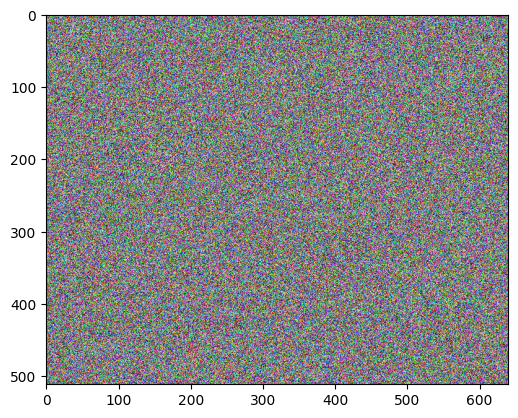

[ Step: 50 / Content loss: 0.7488501071929932]


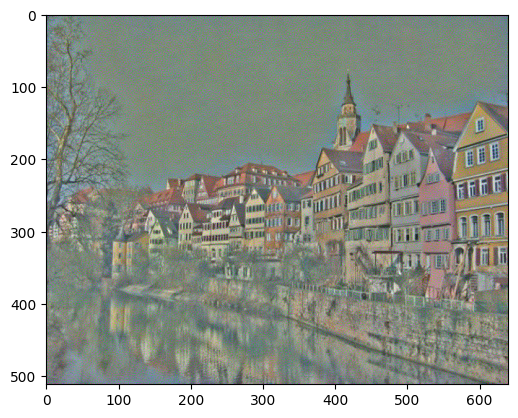

[ Step: 100 / Content loss: 0.3743540942668915]


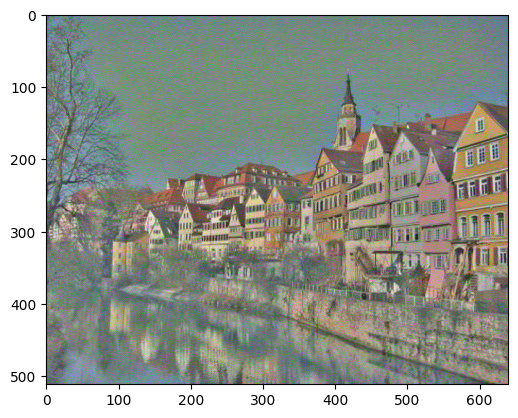

[ Step: 150 / Content loss: 0.24150946736335754]


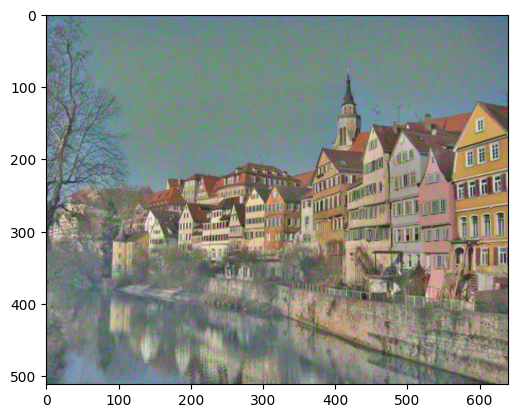

[ Step: 200 / Content loss: 0.17363107204437256]


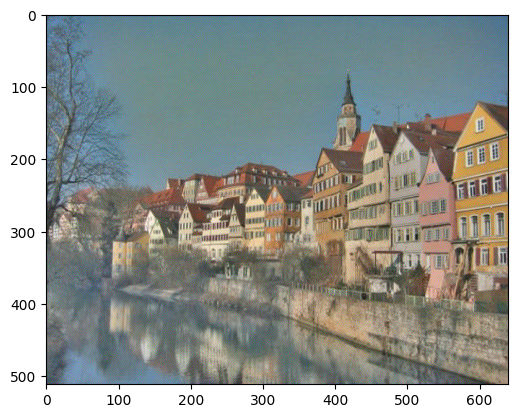

[ Step: 250 / Content loss: 0.13289491832256317]


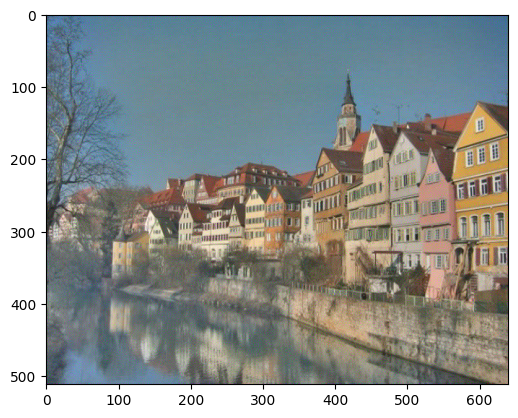

[ Step: 300 / Content loss: 0.10302262008190155]


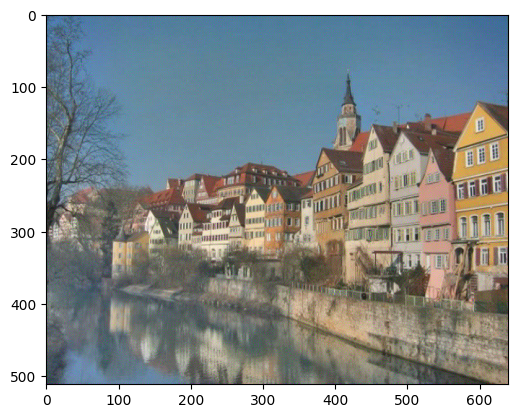

In [36]:
# content reconstruction 수행
output = content_reconstruction(cnn, content_img=content_img, input_img=input_img, iters=300)

#### Style Loss

<img src="https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FNRe0V%2FbtsiOKd9qvx%2FifzWKsqIkYBdaU4pjdRJ01%2Fimg.png" width=500>

<br>

style: 서로 다른 feature 간의 상관관계. <br>
&nbsp;&nbsp;&nbsp;&nbsp; ex) 하나의 feature에서 높은 activation값이 나왔다고 하면 다른 하나의 feature에서도 높은 activation값이 나오는 것을 의미. <br>
feature map의 수가 4개이면 4x4의 matrix 생성 가능. <br>

<br>

<img src="https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FtlgXl%2FbtrmEYMZDKa%2FHZv6HrKOx6THxDA1pxmRYK%2Fimg.png" width=500>

<br>

위의 gram matrix가 같도록 만들어 두 이미지 간의 style이 유사할 수 있도록 함. <br>

In [ ]:
def gram_matrix(input):
    # a는 배치 크기, b는 특징 맵의 개수, (c, d)는 특징 맵의 차원을 의미
    a, b, c, d = input.size()
    # 논문에서는 i = 특징 맵의 개수, j = 각 위치(position)
    features = input.view(a * b, c * d)
    # 행렬 곱으로 한 번에 Gram 내적 계산 가능
    G = torch.mm(features, features.t())
    # Normalize 목적으로 값 나누기
    return G.div(a * b * c * d)


# 스타일 손실(style loss) 계산을 위한 클래스 정의
class StyleLoss(nn.Module):
    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = gram_matrix(target_feature).detach()

    def forward(self, input):
        G = gram_matrix(input)
        self.loss = F.mse_loss(G, self.target)
        return input


style_layers = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

# 스타일 손실(style loss)을 계산하는 함수
def get_style_losses(cnn, style_img, noise_image):
    cnn = copy.deepcopy(cnn)
    normalization = Normalization(cnn_normalization_mean, cnn_normalization_std).to(device)
    style_losses = []

    # 가장 먼저 입력 이미지가 입력 정규화(input normalization)를 수행하도록
    model = nn.Sequential(normalization)

    # 현재 CNN 모델에 포함되어 있는 모든 레이어를 확인하며
    i = 0
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        model.add_module(name, layer)

        # 설정한 style layer까지의 결과를 이용해 style loss를 계산
        if name in style_layers:
            target_feature = model(style_img).detach()
            style_loss = StyleLoss(target_feature)
            model.add_module("style_loss_{}".format(i), style_loss)
            style_losses.append(style_loss)

    # 마지막 style loss 이후의 레이어는 사용하지 않도록
    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], StyleLoss):
            break

    model = model[:(i + 1)]

    return model, style_losses

def style_reconstruction(cnn, style_img, input_img, iters):
    model, style_losses = get_style_losses(cnn, style_img, input_img)
    optimizer = optim.LBFGS([input_img.requires_grad_()])

    print("[ Start ]")
    imshow(input_img)

    # 하나의 값만 이용하기 위해 배열 형태로 사용
    run = [0]
    while run[0] <= iters:

        def closure():
            input_img.data.clamp_(0, 1)

            optimizer.zero_grad()
            model(input_img)
            style_score = 0

            for sl in style_losses:
                style_score += sl.loss

            style_score *= 1e6
            style_score.backward()

            run[0] += 1
            if run[0] % 50 == 0:
                print(f"[ Step: {run[0]} / Style loss: {style_score.item()}]")
                imshow(input_img)

            return style_score

        optimizer.step(closure)

    # 결과적으로 이미지의 각 픽셀의 값이 [0, 1] 사이의 값이 되도록 자르기
    input_img.data.clamp_(0, 1)

    return input_img

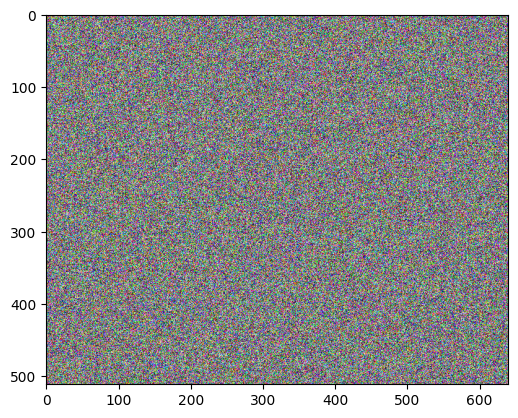

In [38]:
# 콘텐츠 이미지와 동일한 크기의 노이즈 이미지 준비하기
input_img = torch.empty_like(content_img).uniform_(0, 1).to(device)
imshow(input_img)

[ Start ]


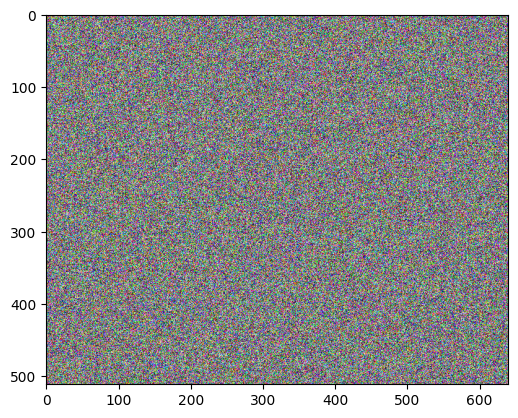

[ Step: 50 / Style loss: 389.2127685546875]


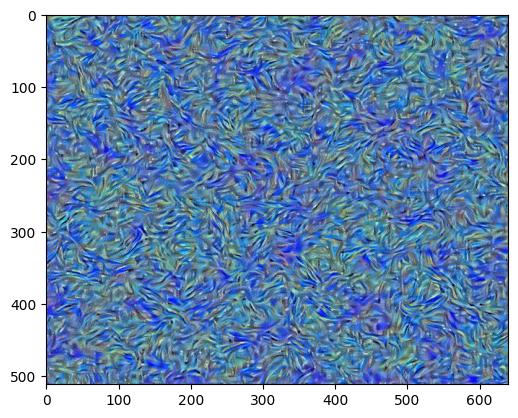

[ Step: 100 / Style loss: 93.07196044921875]


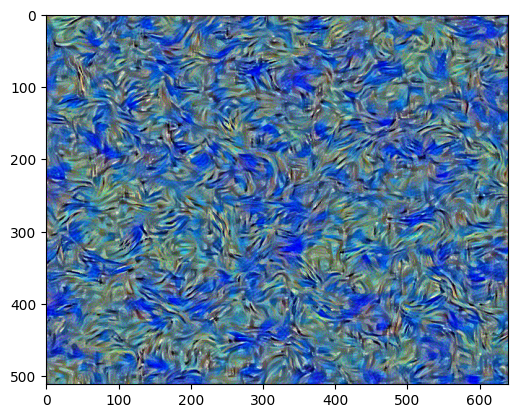

[ Step: 150 / Style loss: 47.65583801269531]


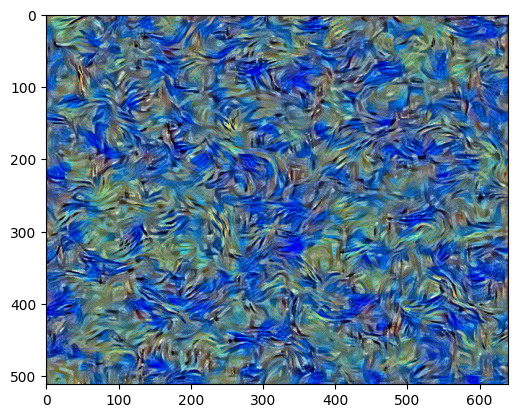

[ Step: 200 / Style loss: 34.05777359008789]


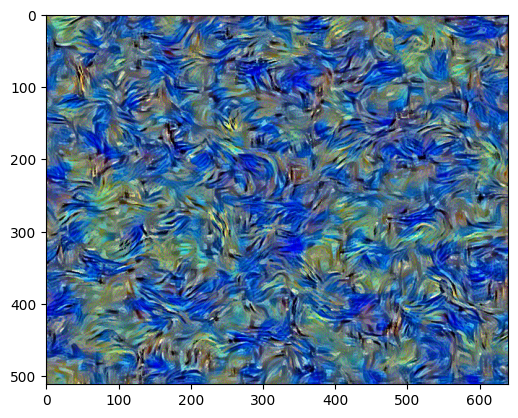

[ Step: 250 / Style loss: 26.808332443237305]


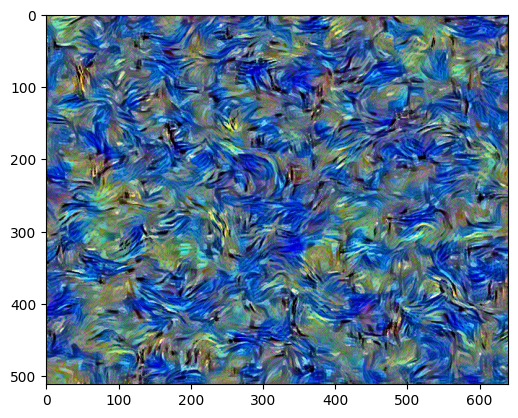

[ Step: 300 / Style loss: 21.789907455444336]


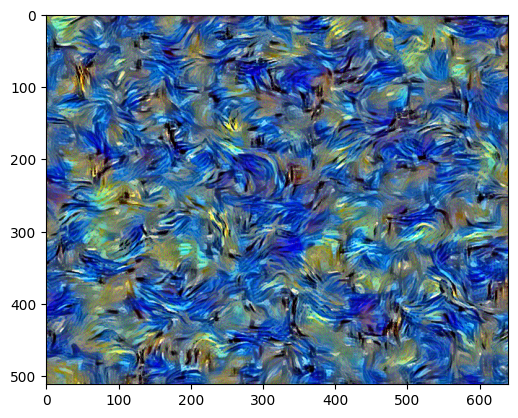

In [39]:
# style reconstruction 수행
output = style_reconstruction(cnn, style_img=style_img, input_img=input_img, iters=300)

## 한계

<img src="https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FHtRGT%2FbtsiPQLDDUV%2F4kyYB9YtNq8NPs2Qa86tA0%2Fimg.png" width=500>

<br>

style과 content의 구분이 명확하지 못할 때가 있음.

## Practice

In [40]:
content_layers = ['conv_4']
style_layers = ['conv_1', 'conv_3', 'conv_5', 'conv_7', 'conv_9']

# Style Transfer 손실(loss)을 계산하는 함수
def get_losses(cnn, content_img, style_img, noise_image):
    cnn = copy.deepcopy(cnn)
    normalization = Normalization(cnn_normalization_mean, cnn_normalization_std).to(device)
    content_losses = []
    style_losses = []

    # 가장 먼저 입력 이미지가 입력 정규화(input normalization)를 수행하도록
    model = nn.Sequential(normalization)

    # 현재 CNN 모델에 포함되어 있는 모든 레이어를 확인하며
    i = 0
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        model.add_module(name, layer)

        # 설정한 content layer까지의 결과를 이용해 content loss를 계산
        if name in content_layers:
            target_feature = model(content_img).detach()
            content_loss = ContentLoss(target_feature)
            model.add_module("content_loss_{}".format(i), content_loss)
            content_losses.append(content_loss)

        # 설정한 style layer까지의 결과를 이용해 style loss를 계산
        if name in style_layers:
            target_feature = model(style_img).detach()
            style_loss = StyleLoss(target_feature)
            model.add_module("style_loss_{}".format(i), style_loss)
            style_losses.append(style_loss)

    # 마지막 loss 이후의 레이어는 사용하지 않도록
    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
            break

    model = model[:(i + 1)]
    return model, content_losses, style_losses

def style_transfer(cnn, content_img, style_img, input_img, iters):
    model, content_losses, style_losses = get_losses(cnn, content_img, style_img, input_img)
    optimizer = optim.LBFGS([input_img.requires_grad_()])

    print("[ Start ]")
    imshow(input_img)

    # 하나의 값만 이용하기 위해 배열 형태로 사용
    run = [0]
    while run[0] <= iters:

        def closure():
            input_img.data.clamp_(0, 1)

            optimizer.zero_grad()
            model(input_img)
            content_score = 0
            style_score = 0

            for cl in content_losses:
                content_score += cl.loss
            for sl in style_losses:
                style_score += sl.loss

            style_score *= 1e5
            loss = content_score + style_score
            loss.backward()

            run[0] += 1
            if run[0] % 100 == 0:
                print(f"[ Step: {run[0]} / Content loss: {content_score.item()} / Style loss: {style_score.item()}]")
                imshow(input_img)

            return content_score + style_score

        optimizer.step(closure)

    # 결과적으로 이미지의 각 픽셀의 값이 [0, 1] 사이의 값이 되도록 자르기
    input_img.data.clamp_(0, 1)

    return input_img

[ Content Image ]


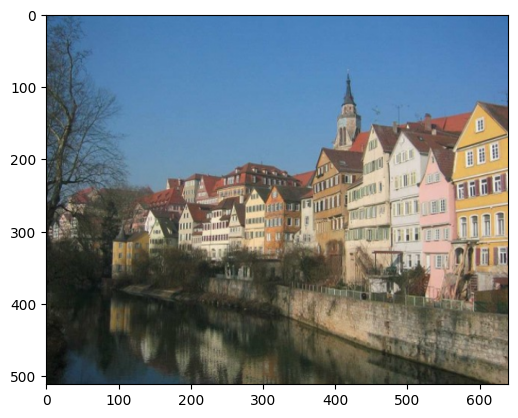

[ Style Image ]


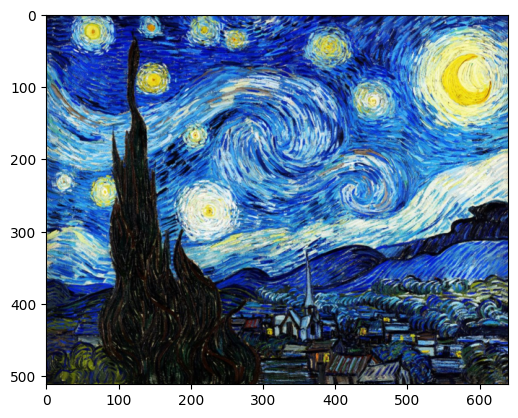

In [41]:
# 콘텐츠(Content) 이미지와 스타일(Style) 이미지를 모두 준비합니다.
content_img = image_loader('./images/content_img_1.jpg', (512, 640))
style_img = image_loader('./images/style_img_1.jpg', (512, 640))

print("[ Content Image ]")
imshow(content_img)
print("[ Style Image ]")
imshow(style_img)

[ Start ]


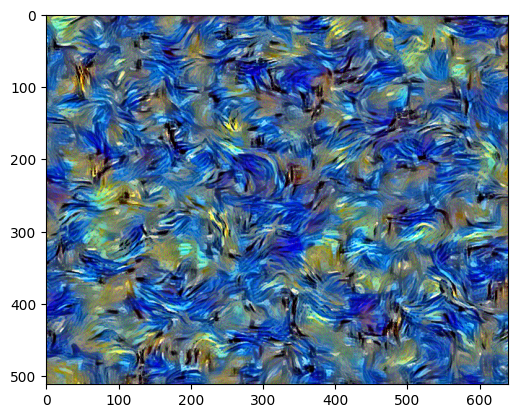

[ Step: 100 / Content loss: 37.92121124267578 / Style loss: 3.874216079711914]


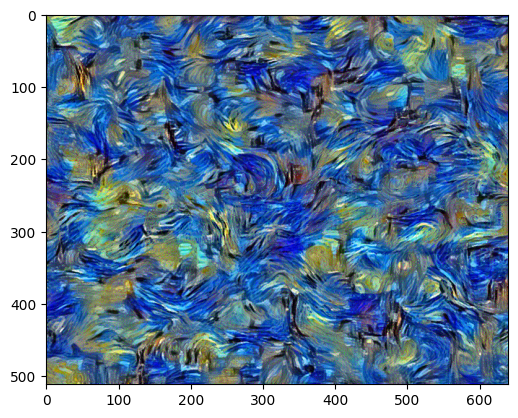

[ Step: 200 / Content loss: 30.502796173095703 / Style loss: 3.5380170345306396]


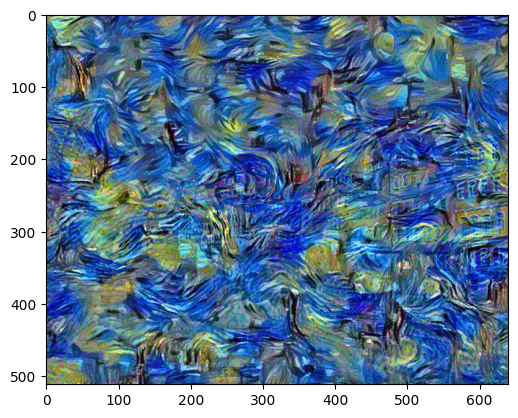

[ Step: 300 / Content loss: 26.68033790588379 / Style loss: 3.0654001235961914]


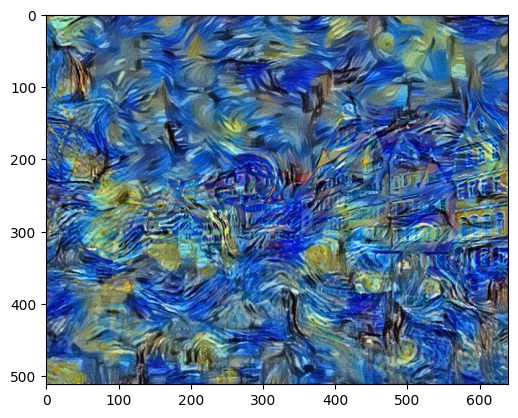

[ Step: 400 / Content loss: 24.296335220336914 / Style loss: 2.929307699203491]


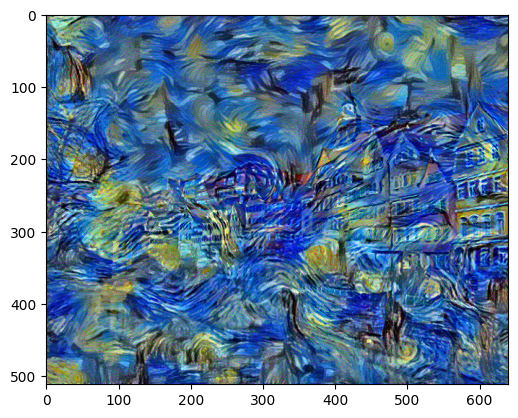

[ Step: 500 / Content loss: 22.81692886352539 / Style loss: 2.8247909545898438]


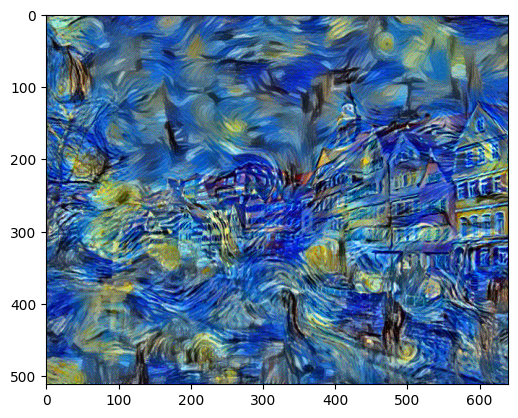

[ Step: 600 / Content loss: 21.64484214782715 / Style loss: 2.7169899940490723]


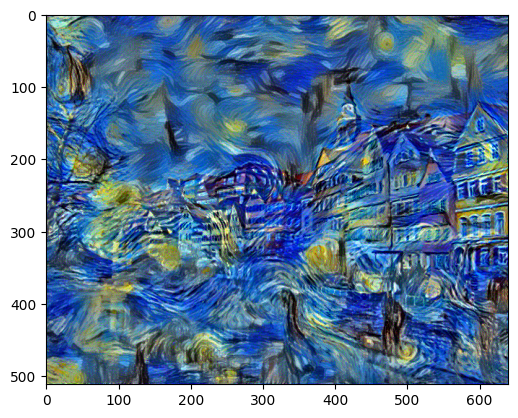

[ Step: 700 / Content loss: 20.790010452270508 / Style loss: 2.624906063079834]


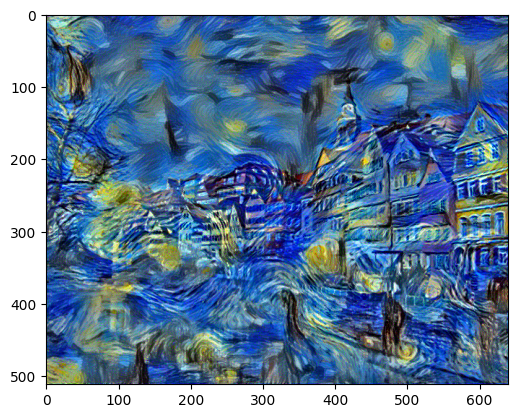

[ Step: 800 / Content loss: 20.023921966552734 / Style loss: 2.973936080932617]


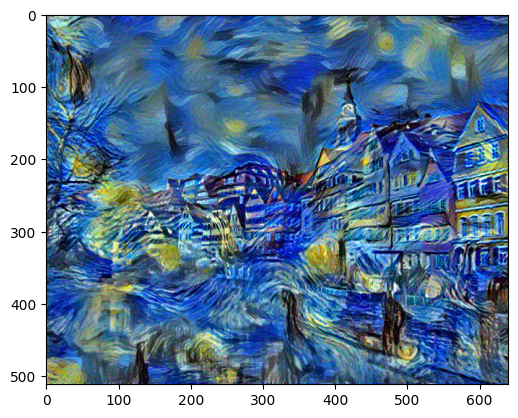

[ Step: 900 / Content loss: 19.68140411376953 / Style loss: 2.550593852996826]


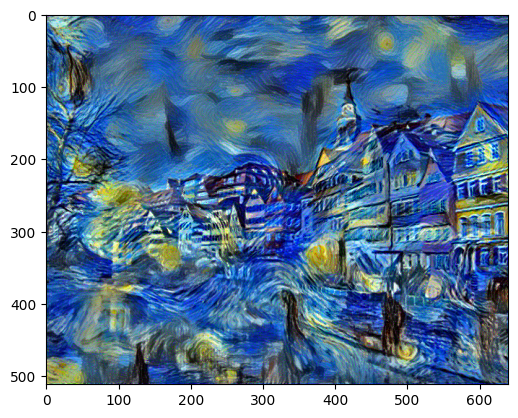

In [42]:
# style transfer 수행
output = style_transfer(cnn, content_img=content_img, style_img=style_img, input_img=input_img, iters=900)

In [43]:
# Practice

# 파이리(charmander) + 지브리풍(style), size: 600 * 600
# content*0.4, style*0.6

[ Content Image ]


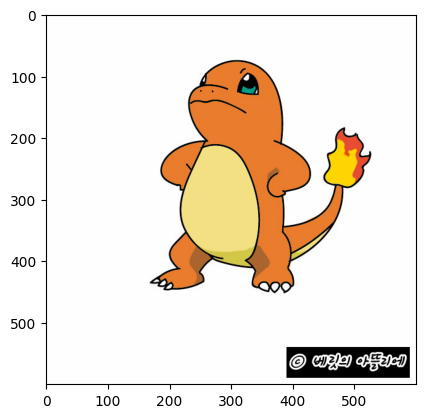

[ Style Image ]


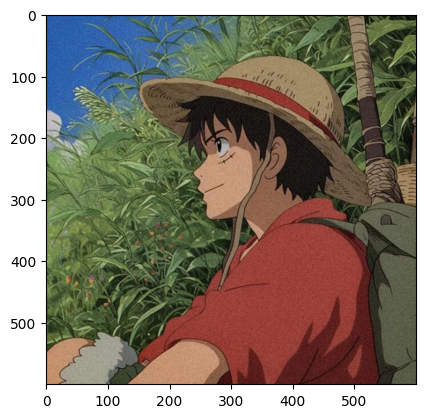

In [47]:
# 콘텐츠(Content) 이미지와 스타일(Style) 이미지를 모두 준비합니다.
content_img = image_loader('./images/charmander.jpg', (600, 600))
style_img = image_loader('./images/Ghibli_Luffy.jpeg', (600, 600))

print("[ Content Image ]")
imshow(content_img)
print("[ Style Image ]")
imshow(style_img)

In [45]:
content_layers = ['conv_4']
style_layers = ['conv_1', 'conv_3', 'conv_5', 'conv_7', 'conv_9']

# Style Transfer 손실(loss)을 계산하는 함수
def get_losses(cnn, content_img, style_img, noise_image):
    cnn = copy.deepcopy(cnn)
    normalization = Normalization(cnn_normalization_mean, cnn_normalization_std).to(device)
    content_losses = []
    style_losses = []

    # 가장 먼저 입력 이미지가 입력 정규화(input normalization)를 수행하도록
    model = nn.Sequential(normalization)

    # 현재 CNN 모델에 포함되어 있는 모든 레이어를 확인하며
    i = 0
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        model.add_module(name, layer)

        # 설정한 content layer까지의 결과를 이용해 content loss를 계산
        if name in content_layers:
            target_feature = model(content_img).detach()
            content_loss = ContentLoss(target_feature)
            model.add_module("content_loss_{}".format(i), content_loss)
            content_losses.append(content_loss)

        # 설정한 style layer까지의 결과를 이용해 style loss를 계산
        if name in style_layers:
            target_feature = model(style_img).detach()
            style_loss = StyleLoss(target_feature)
            model.add_module("style_loss_{}".format(i), style_loss)
            style_losses.append(style_loss)

    # 마지막 loss 이후의 레이어는 사용하지 않도록
    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
            break

    model = model[:(i + 1)]
    return model, content_losses, style_losses

def style_transfer(cnn, content_img, style_img, input_img, iters):
    model, content_losses, style_losses = get_losses(cnn, content_img, style_img, input_img)
    optimizer = optim.LBFGS([input_img.requires_grad_()])

    print("[ Start ]")
    imshow(input_img)

    # 하나의 값만 이용하기 위해 배열 형태로 사용
    run = [0]
    while run[0] <= iters:

        def closure():
            input_img.data.clamp_(0, 1)

            optimizer.zero_grad()
            model(input_img)
            content_score = 0
            style_score = 0

            for cl in content_losses:
                content_score += cl.loss
            for sl in style_losses:
                style_score += sl.loss

            style_score *= 1e5
            loss = content_score*0.4 + style_score*0.6
            loss.backward()

            run[0] += 1
            if run[0] % 100 == 0:
                print(f"[ Step: {run[0]} / Content loss: {content_score.item()} / Style loss: {style_score.item()}]")
                imshow(input_img)

            return content_score + style_score

        optimizer.step(closure)

    # 결과적으로 이미지의 각 픽셀의 값이 [0, 1] 사이의 값이 되도록 자르기
    input_img.data.clamp_(0, 1)

    return input_img

[ Start ]


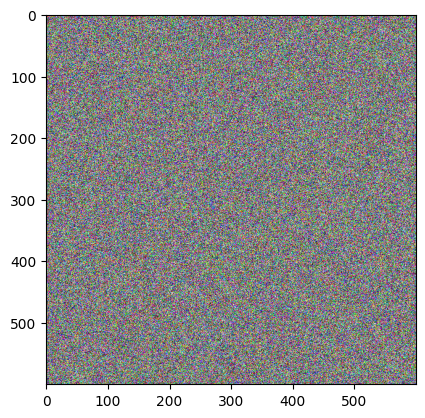

[ Step: 100 / Content loss: 26.794639587402344 / Style loss: 14.717720031738281]


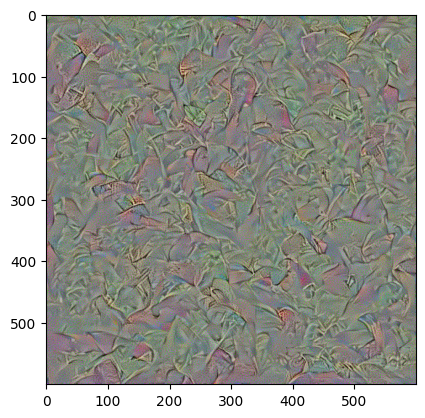

[ Step: 200 / Content loss: 19.944856643676758 / Style loss: 6.679141521453857]


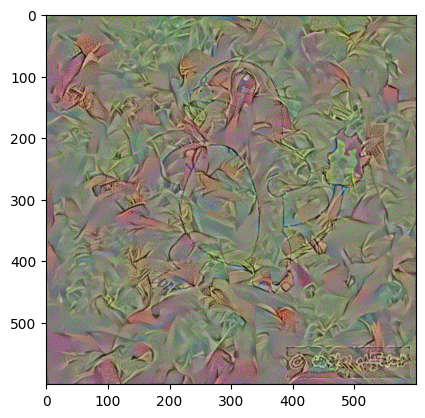

[ Step: 300 / Content loss: 16.26913833618164 / Style loss: 4.022624969482422]


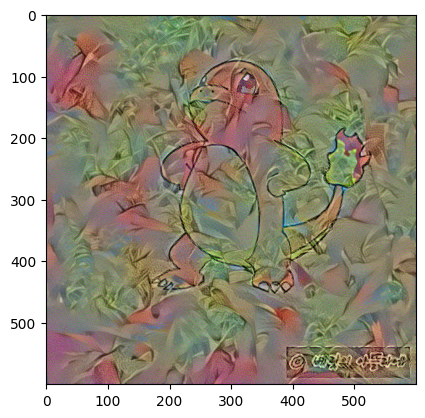

[ Step: 400 / Content loss: 14.555753707885742 / Style loss: 2.849111557006836]


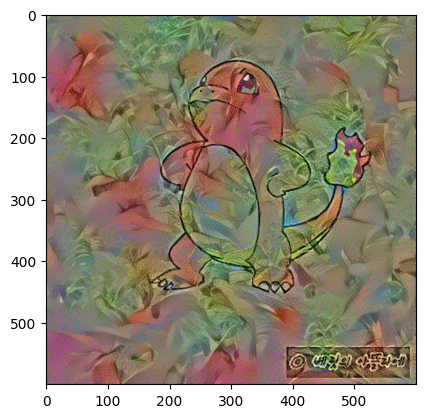

[ Step: 500 / Content loss: 13.61867618560791 / Style loss: 2.1321640014648438]


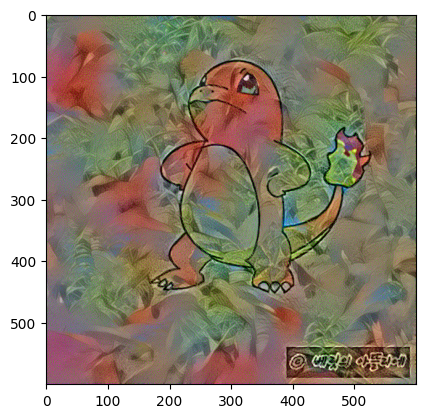

[ Step: 600 / Content loss: 20.229997634887695 / Style loss: 12.192533493041992]


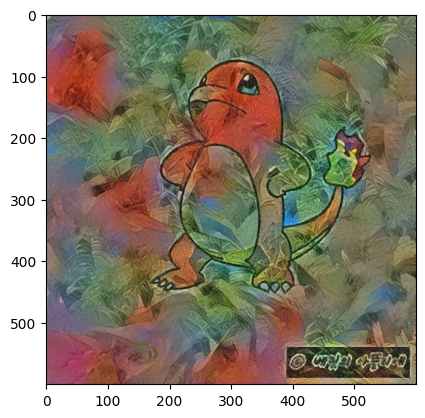

[ Step: 700 / Content loss: 13.973522186279297 / Style loss: 1.5362958908081055]


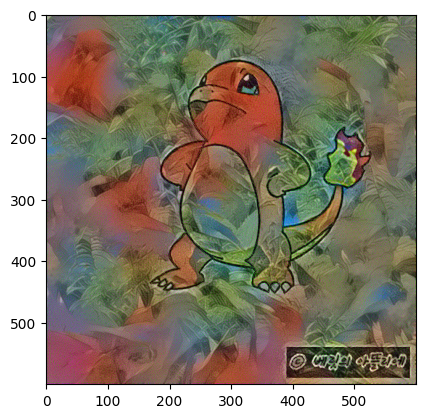

[ Step: 800 / Content loss: 12.601251602172852 / Style loss: 1.3267130851745605]


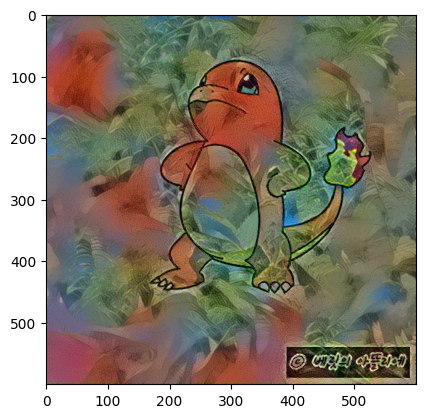

[ Step: 900 / Content loss: 12.261730194091797 / Style loss: 1.206429123878479]


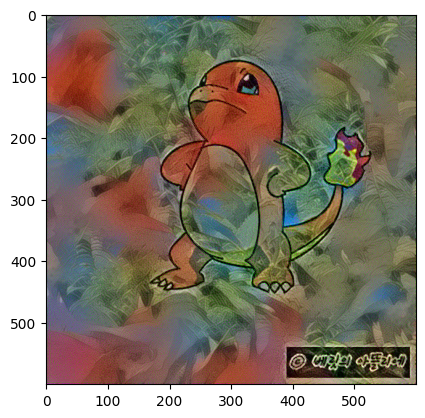

In [51]:
# style transfer 수행
noise_image = torch.empty_like(content_img).uniform_(0, 1).to(device)
output = style_transfer(cnn, content_img=content_img, style_img=style_img, input_img=noise_image, iters=900)